In [1]:
%%HTML
<style> code {background-color : pink !important;} </style>

In [2]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
%matplotlib inline

Camera Calibration with OpenCV
===

### Run the code in the cell below to extract object points and image points for camera calibration.  

##### For camera calibration, a set of chessboard images are chosen. These images have 9 inner points in x direction and 6 inner points in y direction. objp matrix is initialized with sequence values using numpy's mgrid function. OpenCV's findChessboardCorners is used to identify the imgpoints. Then OpenCV's calibrateCamera function is used to calibrate the camera to remove distortions. The mtx and dist matrices returned by calibrateCamera function are used to remove the distortions in images.

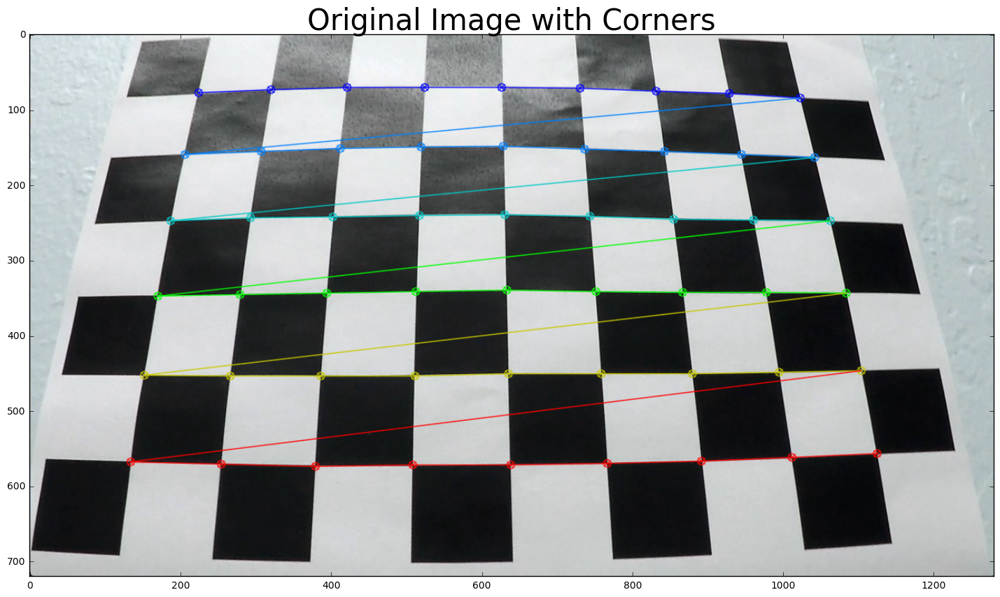

In [3]:
# inner points in x and y directions
nx=9
ny=6

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0) - coordinates of the inner points - z axis value
# is 0 for all

# 20 calibration images are taken from camera_cal folder and findChessboardCorners function is used to 
# map objpoints to imgpoints

objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/CALI*.jpg')
imgshape = None


imgCount = 0

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    imgshape = img.shape
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        #print(fname)
        if fname == 'camera_cal\calibration3.jpg':
            cv2.imwrite('camera_cal/calibration3_corners.jpg',img)
            f, ax1 = plt.subplots(1, 1, figsize=(20,10))
            ax1.imshow(img)
            ax1.set_title('Original Image with Corners', fontsize=30)
    
        imgCount+= 1
        cv2.imshow('img', img)    
        
        cv2.waitKey(500)

cv2.destroyAllWindows()

### If the above cell ran sucessfully, you should now have `objpoints` and `imgpoints` needed for camera calibration.  Run the cell below to calibrate, calculate distortion coefficients, and test undistortion on an image!

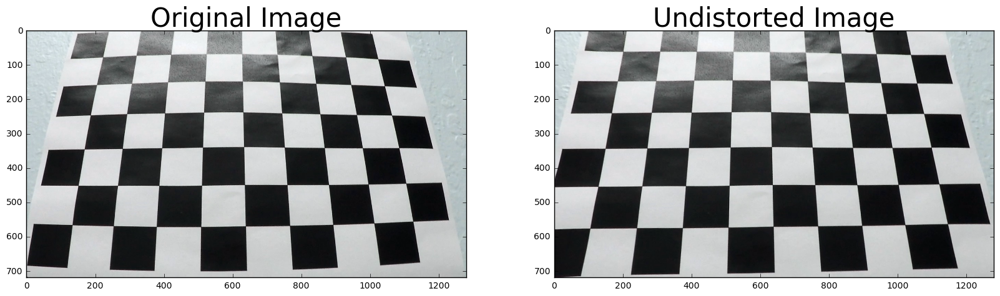

In [4]:
# After getting imgpoints corresponding to objPoints, calibrateCamera function is used to get mtx and dist matrices
# to remove distortion from images

# Test undistortion on an image
img = cv2.imread('camera_cal/calibration3.jpg')
img = cv2.resize(img,(imgshape[1],imgshape[0]) )
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


undist = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('camera_cal/calibration3_undist.jpg',undist)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/wide_dist_pickle_new.p", "wb" ) )

#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=30)

##### After identifying corners and calibrating camera using calibrateCamera function, mtx and dist matrices are obtained to be used in future for undistorting images. OpenCv's undistort function is used to remove edge distortions. We can see in the above images that the edge distortions in camera images are removed.

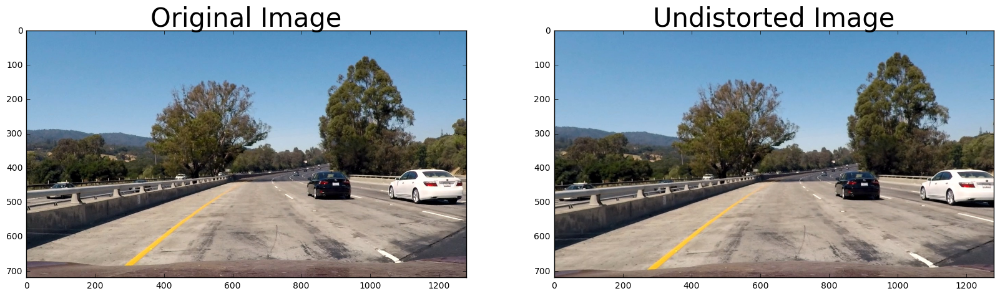

In [5]:
# Test undistortion on an image
img = cv2.imread('test_images/test1.jpg')
img = cv2.resize(img,(imgshape[1],imgshape[0]) )
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
#ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
dist_pickle = {}
with open("camera_cal/wide_dist_pickle_new.p", mode='rb') as f:
    dist_pickle = pickle.load(f)

savedMtx = np.float64(dist_pickle["mtx"])
savedDist = np.float64(dist_pickle["dist"])

undist = cv2.undistort(img, savedMtx, savedDist, None, savedMtx)
cv2.imwrite('test_images/undist_test1.jpg',undist)

img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
undist = cv2.cvtColor(undist, cv2.COLOR_BGR2RGB)

# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=30)


##### Earlier generated mtx and dist matrices are used in undistort function to remove distortions in actual images to be used later in video. We can see in the above right image that distortions are removed near white car rear on the right side and near the other car on the other side of road on the left side of image.

##### Following functions are used to create a binary image to finally filter the lane lines

In [6]:
ksize = 3

In [7]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh = (0, 255)):
   
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #gray = img
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize = sobel_kernel)
    
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0])  & (scaled_sobel <= thresh[1]) ] = 1
    
    #binary_output = np.copy(img) # Remove this line
    return binary_output

In [8]:
def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
    # Calculate gradient magnitude
    # Apply threshold
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)    
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    
    scaled_sobel = np.uint8(255*gradmag/np.max(gradmag))
    
    mag_binary = np.zeros_like(scaled_sobel)
    mag_binary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1     
    
    return mag_binary

In [9]:
def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold
    gray = cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1       
    return dir_binary

In [10]:
def color_threshold(image, sobel_kernel=3, threshS=(0, np.pi/2),threshL=(0, np.pi/2), threshV=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]

    #thresh = (100, 255)#90,255
    #threshL = threshV
    
    binary_L = np.zeros_like(L)
    binary_L[(L > threshL[0]) & (L <= threshL[1])] = 1
    
    binary_S = np.zeros_like(S)
    binary_S[(S > threshS[0]) & (S <= threshS[1])] = 1
    
    
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    H = hls[:,:,0]
    S = hls[:,:,1]
    V = hls[:,:,2]

    binary_V = np.zeros_like(V)
    binary_V[(V > threshV[0]) & (V <= threshV[1])] = 1   
    
    
    combined_SV = np.zeros_like(binary_S)
    combined_SV[((binary_S == 1) & ((binary_V == 1)))] = 1
    
    combined_SL = np.zeros_like(binary_S)
    combined_SL[((binary_S == 1) & ((binary_L == 1)))] = 1    
    
    combined_SLV = np.zeros_like(binary_S)
    combined_SLV[((binary_S == 1) & (binary_L == 1) & (binary_V == 1) )] = 1      
    
    return combined_SLV  


##### Combination of sobel threshold for x and y axis and (S of HLS) and (V of HSV) tranforms are used to generate a binary image.

In [11]:
def createBinary(img):
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(12, 255)) 
    grady = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=(25, 255)) 
    
    #mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(30, 150)) #30,150
    #dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 1.3))

    combined = np.zeros_like(gradx)
    #combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1 
    combined[((gradx == 1) & (grady == 1)) ] = 1 


    color_binary = color_threshold(img, sobel_kernel=ksize, threshS = (80,255), threshL = (50,200), threshV = (50,225))


    combined_SVgradXY = np.zeros_like(color_binary)
    combined_SVgradXY[(combined == 1)  | ((color_binary == 1))] = 1 

    return combined_SVgradXY

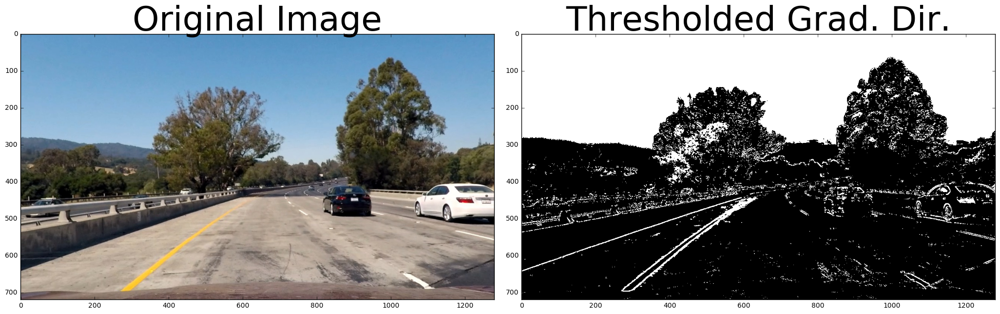

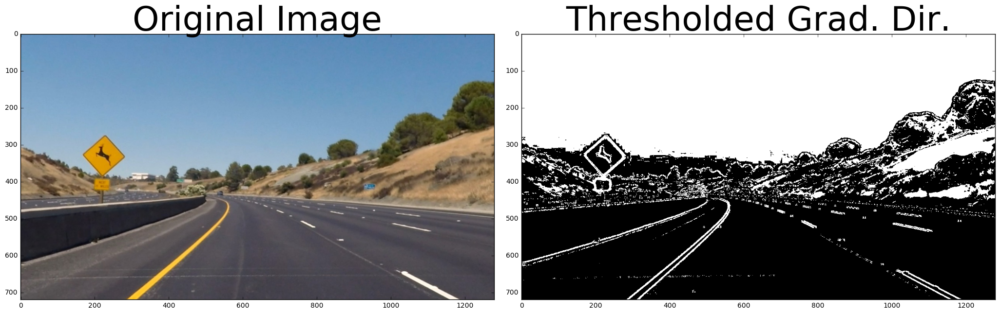

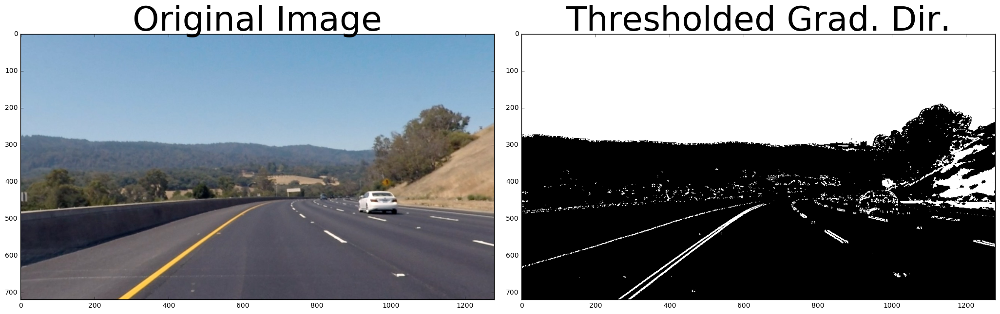

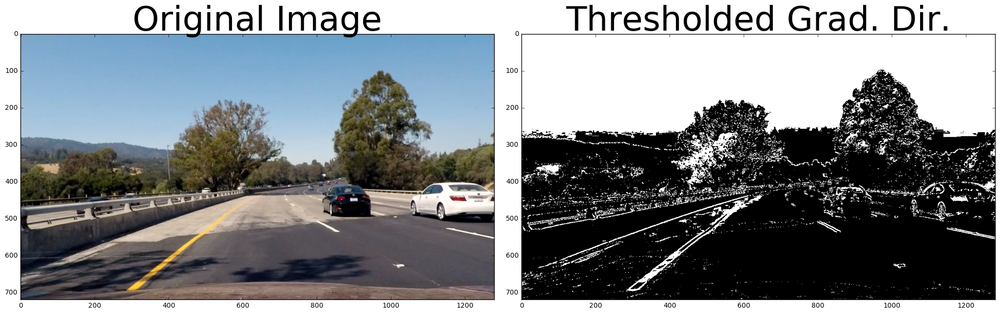

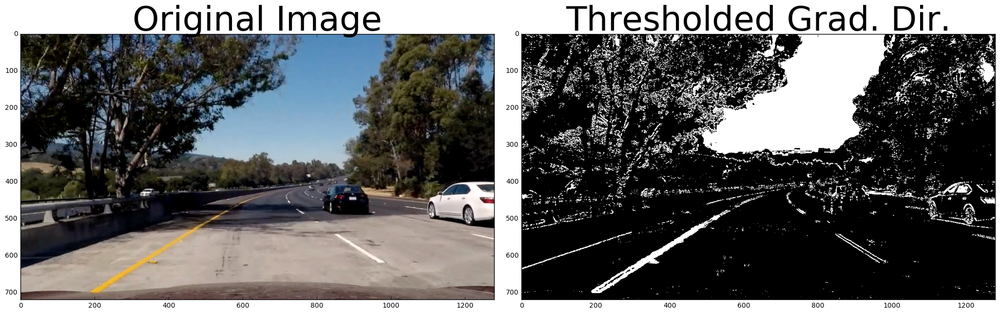

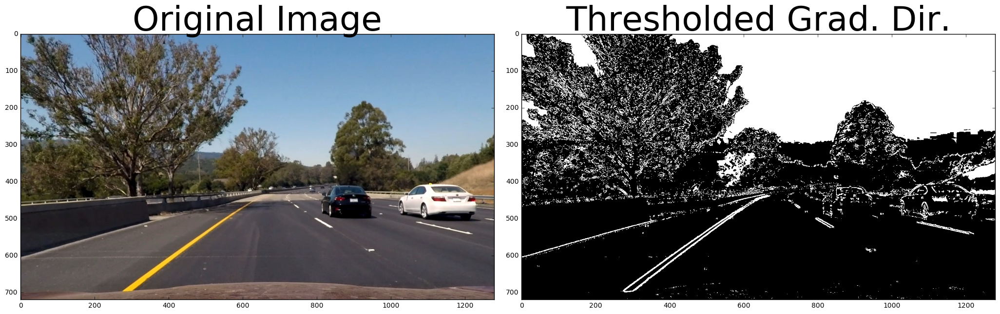

In [12]:
testImages = glob.glob('test_images/test*.jpg')


#imgCount = 0

# Step through the list and search for chessboard corners
for idx, fname in enumerate(testImages):
    img = cv2.imread(fname)
    imgshape = img.shape
    img = cv2.resize(img,(imgshape[1],imgshape[0]) )
    img_size = (img.shape[1], img.shape[0])

    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    
    img = cv2.undistort(img, mtx, dist, None, mtx)
    
    combined_SVgradXY = createBinary(img)
    
    outputFileName = 'test_images/binary_test' +str(idx + 1) + ".png" 
    #cv2.imwrite(outputFileName,combined_SVgradXY, cmap=cm.gray)
    plt.imsave(outputFileName,combined_SVgradXY, cmap='gray')
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 9))
    f.tight_layout()
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(combined_SVgradXY, cmap='gray')
    ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

##### Following warper function is used to undistort the image and create perspective transform. This function returns the binary image after perspective transform and also returns the Inverse transform matrix to be used later to map lane lines on the main image.

In [13]:
def warper(img, nx, ny, src,dest,mtx, dist):
    
    M = cv2.getPerspectiveTransform(np.array(src), np.array(dest))
    MInv = cv2.getPerspectiveTransform(np.array(dest), np.array(src))
 
    #warped = cv2.warpPerspective(img, M, img_size,flags=cv2.INTER_NEAREST) 
    warped = cv2.warpPerspective(img, M, img_size,flags=cv2.INTER_LINEAR) 
   
    return warped, M, MInv

##### Src and destination points for the perspective transform

In [14]:
def setSrcDestVertices():
    
    src = np.float32([[575, 460], [300, 705], [1115, 705], [700, 460]])
    dst = np.float32([[310, 0], [310, 700], [1000,700], [1000, 0]])   
  
    
    return src, dst

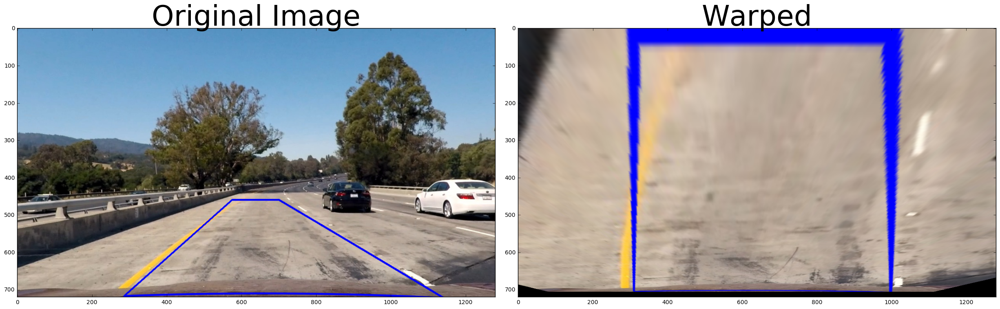

In [15]:
img = cv2.imread('test_images/test1.jpg')
img = cv2.resize(img,(imgshape[1],imgshape[0]) )
img_size = (img.shape[1], img.shape[0])

img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

src_in, dst_in = setSrcDestVertices()

img = cv2.line(img, (src_in[0][0],src_in[0][1]), (src_in[1][0],src_in[1][1]), color = (0,0,255), thickness=3)
img = cv2.line(img, (src_in[1][0],src_in[1][1]), (src_in[2][0],src_in[2][1]), color = (0,0,255), thickness=3)
img = cv2.line(img, (src_in[2][0],src_in[2][1]), (src_in[3][0],src_in[3][1]), color = (0,0,255), thickness=3)
img = cv2.line(img, (src_in[3][0],src_in[3][1]), (src_in[0][0],src_in[0][1]), color = (0,0,255), thickness=3)

#cv2.imwrite('test_images/src_test1.png',img)
plt.imsave('test_images/src_test1.png',img)
img = cv2.undistort(img, mtx, dist, None, mtx) # line added
#combined_SVgradXY = createBinary(img)
warped = warper(img, nx, ny, src_in, dst_in, mtx, dist) 

#binary_warped = warped[0]
#M = warped[1]
#MInv = warped[2]

#cv2.imwrite('test_images/warped_test1.png',warped[0])
plt.imsave('test_images/warped_test1.png',warped[0])

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(warped[0])
ax2.set_title('Warped', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

##### Above image shows the src points on the original image and dest points on the warped image ( using perspective transform)

##### Following histogram shows the peaks corresponding to the left and right lanes.

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:12: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


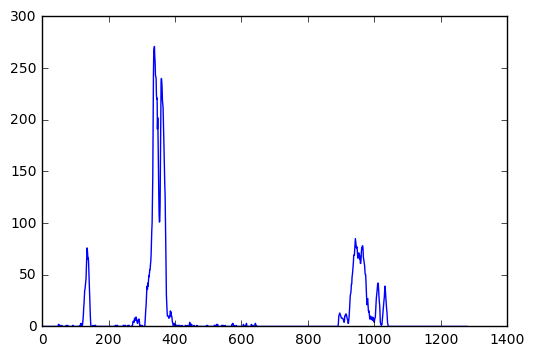

In [16]:
src_in, dst_in = setSrcDestVertices()
img = cv2.imread('test_images/test2.jpg')
img = cv2.resize(img,(imgshape[1],imgshape[0]) )
img_size = (img.shape[1], img.shape[0])
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

img = cv2.undistort(img, mtx, dist, None, mtx) # line added
combined_SVgradXY = createBinary(img)
warped = warper(combined_SVgradXY, nx, ny, src_in, dst_in, mtx, dist) 

binary_warped = warped[0]
histogram = np.sum(binary_warped[binary_warped.shape[0] * 0.5:,:], axis=0)
plt.plot(histogram)

##### Following function is used to draw windows along left and right tracks. 9 windows are drawn along the the tracks. Histogram is used to identify the middle points of left and right lanes. windows are drawn around these mid points. Non zero points are identified within this rectangle and mean of these points is used to find the center of next window on top of the first window at bottom. 9 windows are drawn on top of the each from bottom to top for each left and right tracks.

In [17]:
def getLeftAndRightTracks(binary_warped,drawRectangle):
    histogram = np.sum(binary_warped[binary_warped.shape[0]*0.5:,:], axis=0)
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)    
    window_width = 80 #80

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])    

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base  

    # Set the width of the windows +/- margin
    margin = 80#80

    # Set minimum number of pixels found to recenter window
    minpix = 40
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1)* window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        if drawRectangle:
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
           
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))


    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])  
    
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

  
    #return out_img, left_fitx, right_fitx, left_lane_inds, right_lane_inds, ploty
    return leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds
    

##### Following function is used to fit a second order polynomial through left and right tracks.

In [18]:
def fitPoly(binary_warped, out_img, leftx, lefty,rightx, righty ,left_lane_inds, right_lane_inds,iCount):
    
    # Extract left and right line pixel positions
    # Identify the x and y positions of all nonzero pixels in the image

    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])  

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
   
    return out_img, left_fitx, right_fitx, ploty, left_fit,right_fit

In [19]:
def drawWindows(img):
    img = cv2.resize(img,(imgshape[1],imgshape[0]) )
    img_size = (img.shape[1], img.shape[0])

    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

    img = cv2.undistort(img, mtx, dist, None, mtx) # line added
    combined_SVgradXY = createBinary(img)

    src_in, dst_in = setSrcDestVertices()

    warped = warper(combined_SVgradXY, nx, ny, src_in, dst_in, mtx, dist) 
    binary_warped = warped[0]
    revM = warped[2]
    leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = getLeftAndRightTracks(binary_warped,True)
    out_img, left_fitx, right_fitx, ploty,left_fit,right_fit = fitPoly(binary_warped, out_img,leftx, lefty,rightx, righty, left_lane_inds, right_lane_inds,0)
    window_img = np.zeros_like(out_img)
    margin = 80
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))


    left_curve = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    cv2.polylines(window_img, np.int_([left_curve]), 0, (255,0,0), thickness=15)

    right_curve = np.array([np.transpose(np.vstack([right_fitx, ploty]))])
    cv2.polylines(window_img, np.int_([right_curve]), 0, (255,0,0), thickness=15)

    #window_img = cv2.warpPerspective(window_img, revM, img_size,flags=cv2.INTER_NEAREST)


    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    #result = cv2.addWeighted(img, 1, window_img, 0.3, 0)



    #for i in range(len(left_line_pts) - 1):
    #    cv2.line(img, (x[i], y[i]), (x[i+1], y[i+1]), (0,0,0))

    plt.imshow(result)

    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
   
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    return result

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


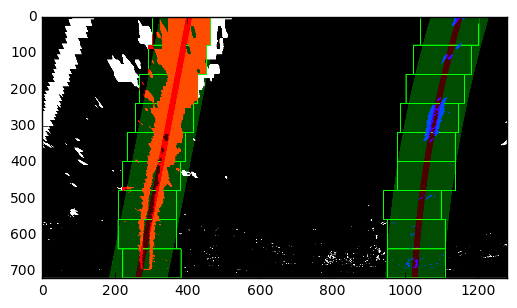

In [20]:
img = cv2.imread('test_images/test1.jpg')
result = drawWindows(img)
plt.imsave('test_images/windows_test1.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


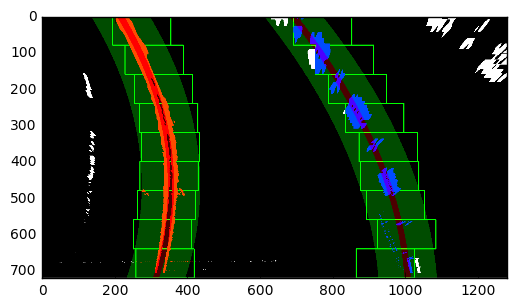

In [21]:
img = cv2.imread('test_images/test2.jpg')
result = drawWindows(img)
plt.imsave('test_images/windows_test2.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


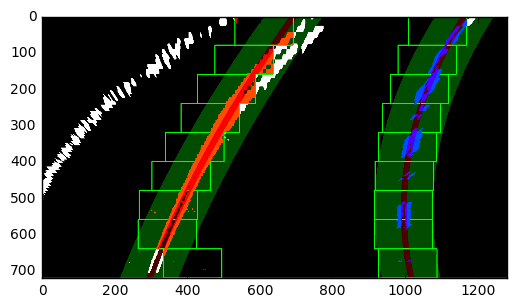

In [22]:
img = cv2.imread('test_images/test3.jpg')
result = drawWindows(img)
plt.imsave('test_images/windows_test3.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


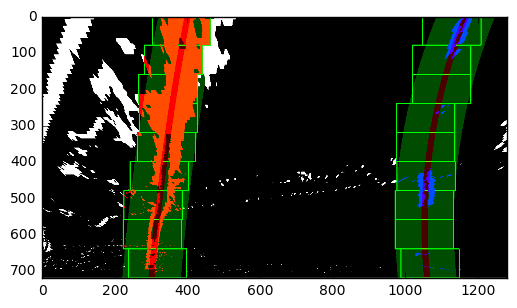

In [23]:
img = cv2.imread('test_images/test4.jpg')
result = drawWindows(img)
plt.imsave('test_images/windows_test4.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


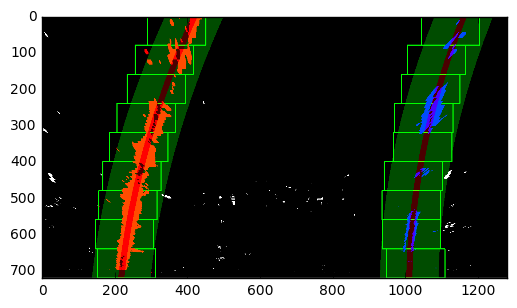

In [24]:
img = cv2.imread('test_images/test5.jpg')
result = drawWindows(img)
plt.imsave('test_images/windows_test5.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


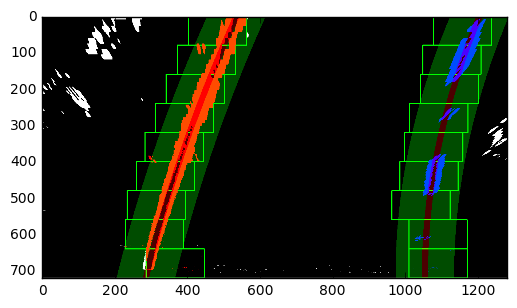

In [25]:
img = cv2.imread('test_images/test6.jpg')
result = drawWindows(img)
plt.imsave('test_images/windows_test6.png',result)

In [26]:
def drawLanes(img):
    img = cv2.resize(img,(imgshape[1],imgshape[0]) )
    img_size = (img.shape[1], img.shape[0])

    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

    img = cv2.undistort(img, mtx, dist, None, mtx) # line added
    combined_SVgradXY = createBinary(img)

    src_in, dst_in = setSrcDestVertices()

    warped = warper(combined_SVgradXY, nx, ny, src_in, dst_in, mtx, dist) 
    binary_warped = warped[0]
    revM = warped[2]
    leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = getLeftAndRightTracks(binary_warped,True)
    out_img, left_fitx, right_fitx, ploty,left_fit,right_fit = fitPoly(binary_warped, out_img,leftx, lefty,rightx, righty, left_lane_inds, right_lane_inds,0)
    window_img = np.zeros_like(out_img)
    margin = 80
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))


    left_curve = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    cv2.polylines(window_img, np.int_([left_curve]), 0, (255,0,0), thickness=15)

    right_curve = np.array([np.transpose(np.vstack([right_fitx, ploty]))])
    cv2.polylines(window_img, np.int_([right_curve]), 0, (255,0,0), thickness=15)

    #window_img = cv2.warpPerspective(window_img, revM, img_size,flags=cv2.INTER_NEAREST)
    window_img = cv2.warpPerspective(window_img, revM, img_size,flags=cv2.INTER_LINEAR)

    result = cv2.addWeighted(img, 1, window_img, 0.3, 0)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(result)
    ax2.set_title('Image with Lanes Drawn', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    

    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    return result

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


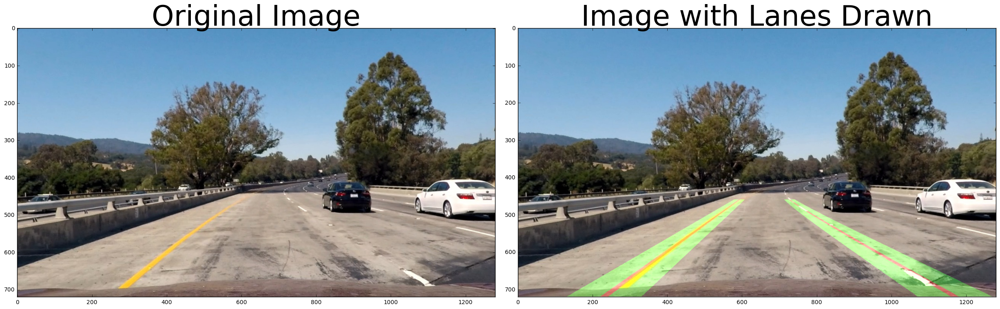

In [27]:
img = cv2.imread('test_images/test1.jpg')
result = drawLanes(img)
plt.imsave('test_images/DrawnLanes_test1.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


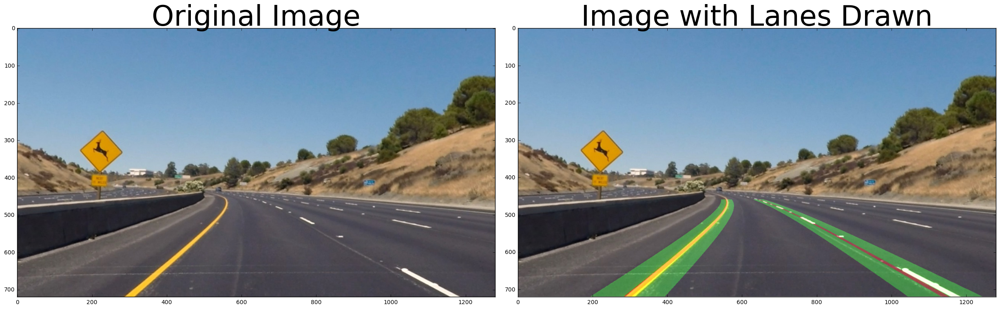

In [28]:
img = cv2.imread('test_images/test2.jpg')
result = drawLanes(img)
plt.imsave('test_images/DrawnLanes_test2.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


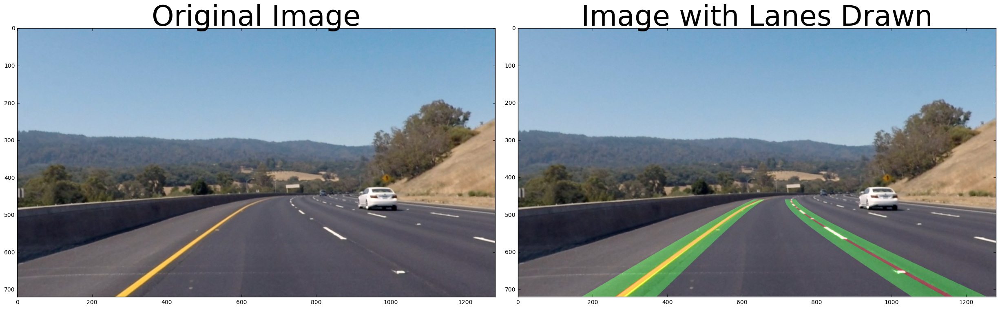

In [29]:
img = cv2.imread('test_images/test3.jpg')
result = drawLanes(img)
plt.imsave('test_images/DrawnLanes_test3.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


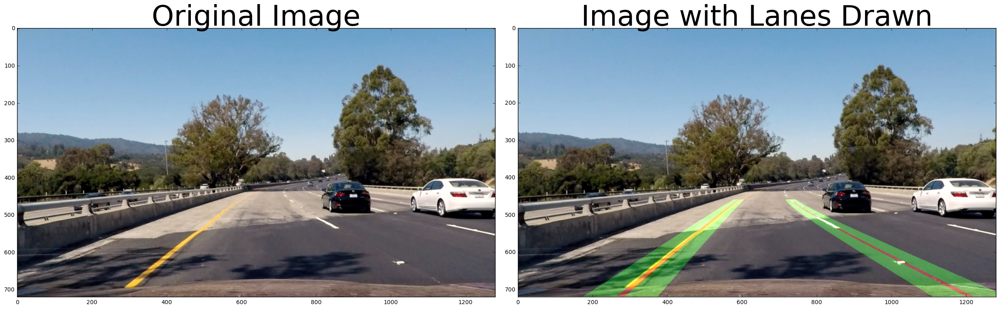

In [30]:
img = cv2.imread('test_images/test4.jpg')
result = drawLanes(img)
plt.imsave('test_images/DrawnLanes_test4.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


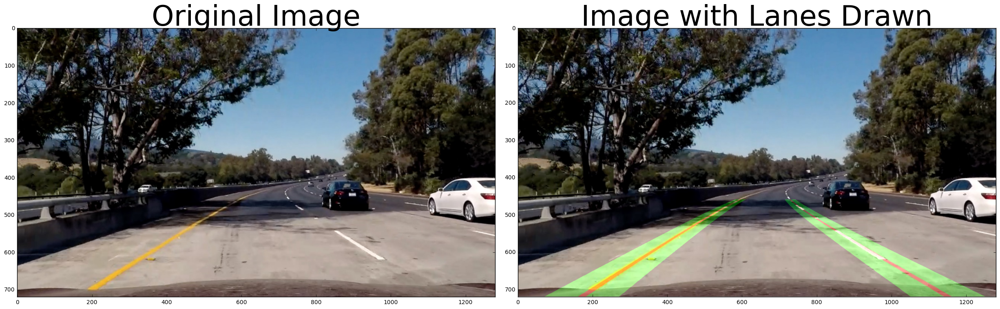

In [31]:
img = cv2.imread('test_images/test5.jpg')
result = drawLanes(img)
plt.imsave('test_images/DrawnLanes_test5.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


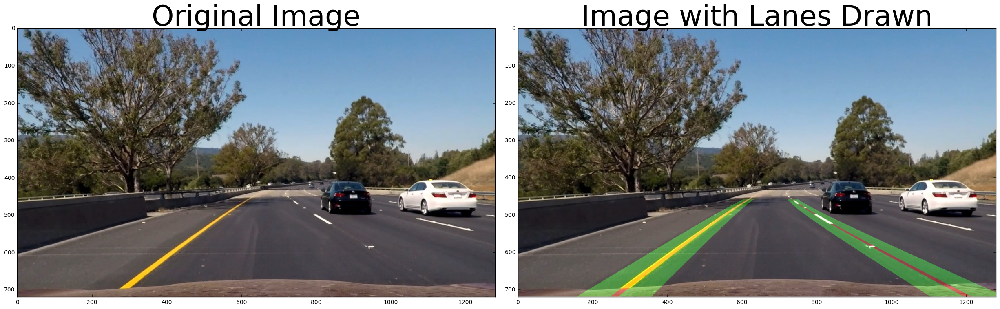

In [32]:
img = cv2.imread('test_images/test6.jpg')
result = drawLanes(img)
plt.imsave('test_images/DrawnLanes_test6.png',result)

##### Following function Process_image is called for each frame of video and it uses the already created functions to generate binary warped image and fit a polynomial.

In [33]:
def findRadiusocCurvatureAndLocation(img,leftx, lefty, rightx, righty, yvals):
    
    y_eval = np.max(yvals)   

    ym_per_pix = 30./720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    left_fit_cr=np.polyfit(np.array(lefty,dtype=np.float32)*ym_per_pix,np.array(leftx,dtype=np.float32)*xm_per_pix,2)
    right_fit_cr=np.polyfit(np.array(righty,dtype=np.float32)*ym_per_pix,np.array(rightx,dtype=np.float32)*xm_per_pix,2)    
    
    y_vals_cr = np.arange(0, img.shape[0] * ym_per_pix)
    
    left_cr_x = left_fit_cr[0]*y_vals_cr**2 + left_fit_cr[1]*y_vals_cr + left_fit_cr[2]
    right_cr_x = right_fit_cr[0]*y_vals_cr**2 + right_fit_cr[1]*y_vals_cr + right_fit_cr[2]     
    
    #polyLeft = np.poly1d(left_fit_cr)
    #left_cr_x = polyLeft(y_vals_cr)    
    #polyRight = np.poly1d(right_fit_cr)
    #right_cr_x = polyRight(y_vals_cr)    
    center_cr_x = np.mean([left_cr_x, right_cr_x], axis=0)
    center_fit_cr = np.polyfit(y_vals_cr, center_cr_x,2)
    
    # Calculate curvature of the lane at the bottom of the image, in meters
    curverad = ((1 + (2*center_fit_cr[0]*y_eval*ym_per_pix + center_fit_cr[1])**2)**1.5) / np.absolute(2*center_fit_cr[0])
    
    
    #polyLeft = np.poly1d(left_fit_cr)
    #left_bottom_x = polyLeft(img.shape[0] * ym_per_pix)    
    #polyRight = np.poly1d(right_fit_cr)
    #right_bottom_x = polyRight(img.shape[0] * ym_per_pix)     
    left_bottom_x = left_fit_cr[0]*(img.shape[0] * ym_per_pix)**2 + left_fit_cr[1]*(img.shape[0] * ym_per_pix)+ left_fit_cr[2]
    right_bottom_x = right_fit_cr[0]*(img.shape[0] * ym_per_pix)**2 + right_fit_cr[1]*(img.shape[0] * ym_per_pix) + right_fit_cr[2]    
    
    
    
    camera_center = (left_bottom_x + right_bottom_x)/2.0
    #center_diff = (camera_center - binary_warped.shape[1]/2) * xm_per_pix
    center_diff = camera_center - (binary_warped.shape[1]/2.) * xm_per_pix
    side_pos = 'left'
    if center_diff <=0 :
        side_pos = 'right'
    
    return curverad, center_diff, side_pos

In [34]:


def process_image(img):    
    
    src_in, dst_in = setSrcDestVertices()
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    combined_SVgradXY = createBinary(undist)     
    warped = warper(combined_SVgradXY, nx, ny, src_in, dst_in, mtx, dist)
    binary_warped = warped[0]
    M = warped[1]
    revM = warped[2]
    
    
    ##########################
    leftx, lefty, rightx, righty, out_img , left_lane_inds, right_lane_inds = getLeftAndRightTracks(binary_warped,False)
        
    yvals = np.linspace(0, img.shape[0], num=img.shape[0])
  

    # Fit a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    left_fitx = left_fit[0]*yvals**2 + left_fit[1]*yvals + left_fit[2]
    right_fit = np.polyfit(righty, rightx, 2)
    right_fitx = right_fit[0]*yvals**2 + right_fit[1]*yvals + right_fit[2]

     # Link all points for cv2.fillPoly() in pix space
    pts_left = np.array([np.transpose(np.vstack([left_fitx, yvals]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, yvals])))])
    

    pts = np.hstack((pts_left, pts_right))

    
    # Draw the lane onto the warped blank image
    out_img = np.zeros_like(undist).astype(np.uint8)
    #color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    cv2.fillPoly(out_img, np.int_([pts]), (0,255, 0))
    cv2.polylines(out_img, np.array([pts_left], dtype=np.int32), False,(255,0,0),thickness = 15)
    cv2.polylines(out_img, np.array([pts_right], dtype=np.int32), False,(0,0,255),thickness = 15)

    
    #####################################################################
    # Calculate curvature radius and location of vehicle
    curverad, center_diff, side_pos = findRadiusocCurvatureAndLocation(img, leftx, lefty, rightx, righty, yvals)
    
    cv2.putText(img, 'Radius of Curvature = ' + str(round(curverad,3)) + '(m)',(50,50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)    
    cv2.putText(img, 'Vehicle offset : ' + str(abs(round(center_diff,3))) + 'm ' + side_pos + ' of center',(50,100), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255),2)    
    
    #unwarp = cv2.warpPerspective(out_img, revM, img_size,flags=cv2.INTER_NEAREST)
    unwarp = cv2.warpPerspective(out_img, revM, img_size,flags=cv2.INTER_LINEAR)
    
    result = cv2.addWeighted(img, 1, unwarp, 0.3, 0) 
    return result
    

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


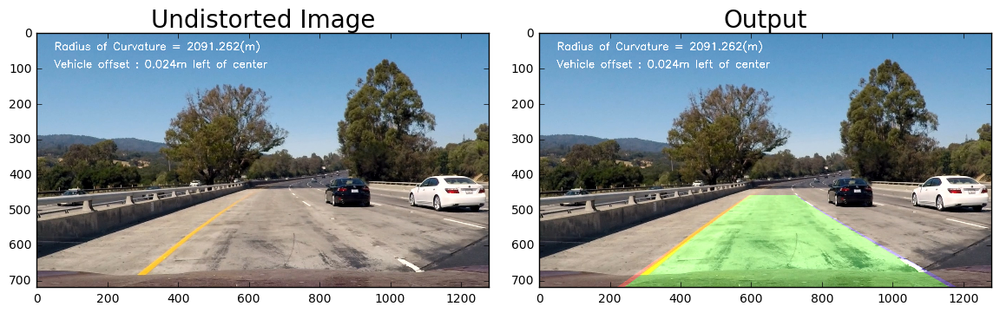

In [35]:
# Read in an image
import matplotlib.image as mpimg
image = cv2.imread('test_images/test1.jpg')
image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)

src, dst = setSrcDestVertices()

result = process_image(image)

plt.imsave('test_images/DrawnArea_test1.png',result)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(11, 5))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Undistorted Image', fontsize=20)
ax2.imshow(result,cmap='gray' )
ax2.set_title('Output', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [36]:
import matplotlib.image as mpimg
def drawArea(image):
    image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)

    src, dst = setSrcDestVertices()

    result = process_image(image)

   

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(11, 5))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(result,cmap='gray' )
    ax2.set_title('Area Drawn', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)  
    return result

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


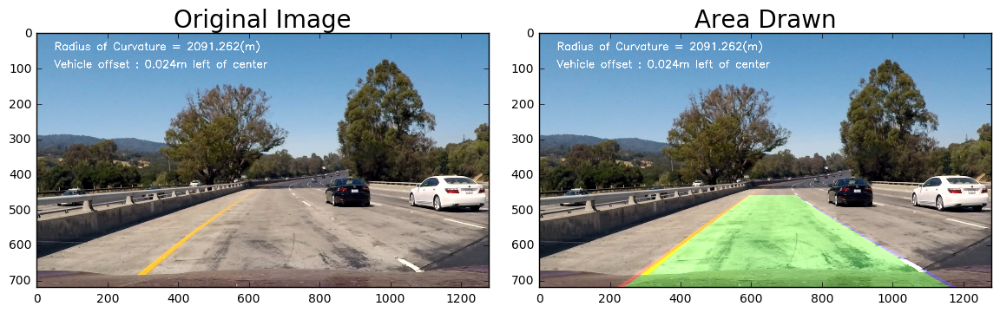

In [37]:
img = cv2.imread('test_images/test1.jpg')
result = drawArea(img)
plt.imsave('test_images/DrawnArea_test1.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


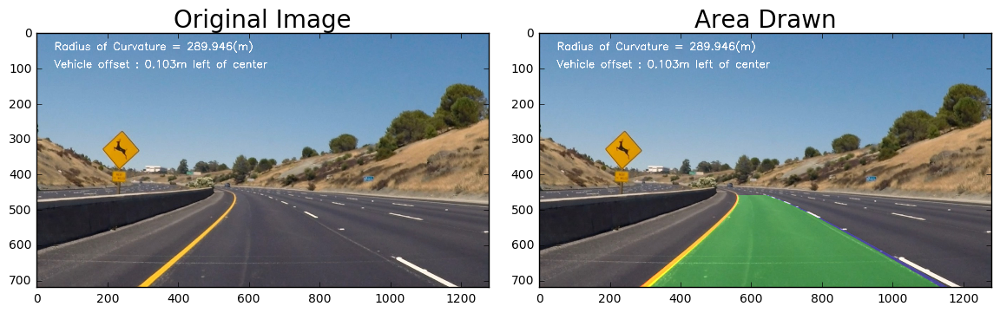

In [38]:
img = cv2.imread('test_images/test2.jpg')
result = drawArea(img)
plt.imsave('test_images/DrawnArea_test2.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


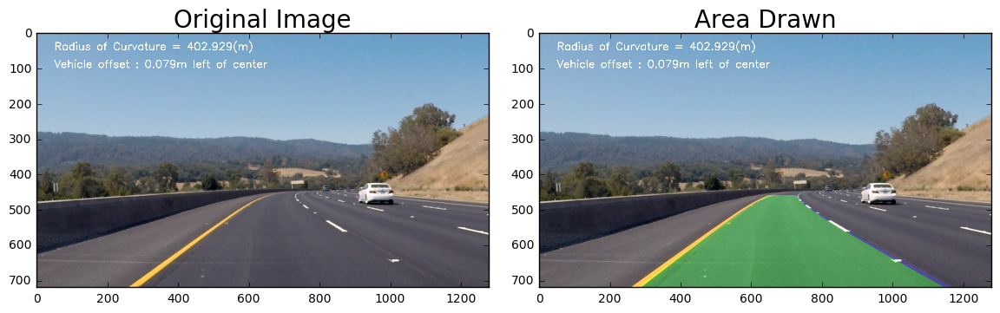

In [39]:
img = cv2.imread('test_images/test3.jpg')
result = drawArea(img)
plt.imsave('test_images/DrawnArea_test3.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


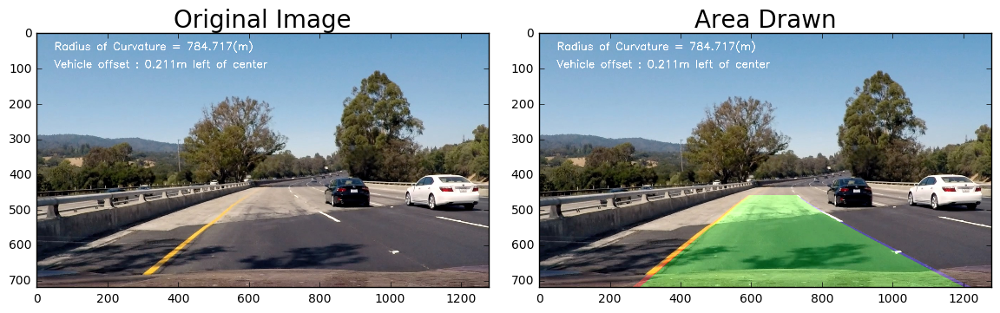

In [40]:
img = cv2.imread('test_images/test4.jpg')
result = drawArea(img)
plt.imsave('test_images/DrawnArea_test4.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


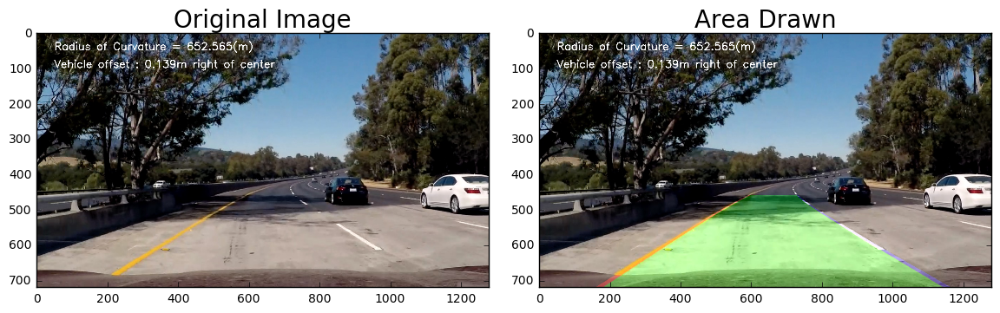

In [41]:
img = cv2.imread('test_images/test5.jpg')
result = drawArea(img)
plt.imsave('test_images/DrawnArea_test5.png',result)

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


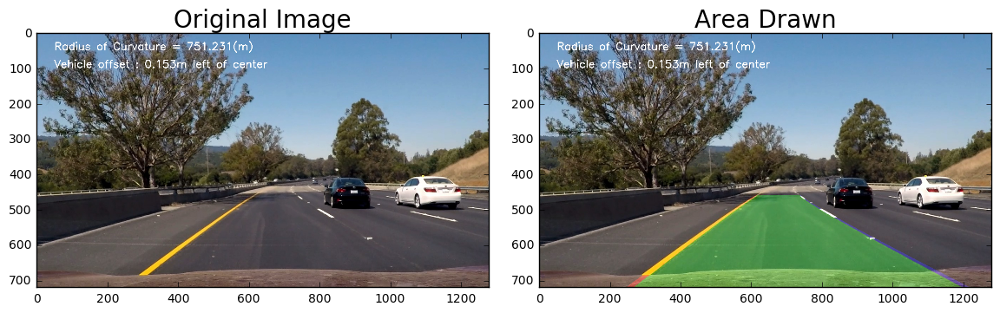

In [42]:
img = cv2.imread('test_images/test6.jpg')
result = drawArea(img)
plt.imsave('test_images/DrawnArea_test6.png',result)

In [43]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
movie_output = 'movie.mp4'
#movie_output = 'movie_challenge.mp4'
#movie_output = 'movie_harder_challenge.mp4'
clip1 = VideoFileClip("project_video.mp4")#challenge_video
#clip1 = VideoFileClip("challenge_video.mp4")#challenge_video # harder_challenge_video
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(movie_output, audio=False)

C:\Users\navneet123\Anaconda3\lib\site-packages\skimage\filter\__init__.py:6: skimage_deprecation: The `skimage.filter` module has been renamed to `skimage.filters`.  This placeholder module will be removed in v0.13.
  warn(skimage_deprecation('The `skimage.filter` module has been renamed '
C:\Users\navneet123\Anaconda3\lib\site-packages\moviepy\audio\io\readers.py:110: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  self.nchannels))



MoviePy: building video file movie.mp4
----------------------------------------

Writing video into movie.mp4
|----------| 0/1210   0% [elapsed: 00:00 left: ?, ? iters/sec]

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app
C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


Done writing video in movie.mp4 !
Your video is ready !
Wall time: 7min 16s


In [44]:

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
#movie_output = 'movie.mp4'
movie_output = 'challenge_video_outut.mp4'
#movie_output = 'movie_harder_challenge.mp4'
#clip1 = VideoFileClip("project_video.mp4")#challenge_video
clip1 = VideoFileClip("challenge_video.mp4")#challenge_video # harder_challenge_video
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(movie_output, audio=False)


C:\Users\navneet123\Anaconda3\lib\site-packages\moviepy\audio\io\readers.py:110: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  self.nchannels))
C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app



MoviePy: building video file challenge_video_outut.mp4
----------------------------------------

Writing video into challenge_video_outut.mp4
|----------| 0/388   0% [elapsed: 00:00 left: ?, ? iters/sec]

C:\Users\navneet123\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


|##--------| 106/388  27% [elapsed: 00:28 left: 01:15,  3.73 iters/sec]

C:\Users\navneet123\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:595: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)
C:\Users\navneet123\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:595: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)


|##--------| 108/388  27% [elapsed: 00:28 left: 01:15,  3.73 iters/sec]

C:\Users\navneet123\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:595: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)
C:\Users\navneet123\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:595: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)


|##--------| 110/388  28% [elapsed: 00:29 left: 01:14,  3.72 iters/sec]

C:\Users\navneet123\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:595: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)


Done writing video in challenge_video_outut.mp4 !
Your video is ready !
Wall time: 2min 10s


In [ ]:
'''
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
#movie_output = 'movie.mp4'
#movie_output = 'movie_challenge.mp4'
movie_output = 'harder_challenge_video_output.mp4'
#clip1 = VideoFileClip("project_video.mp4")#challenge_video
#clip1 = VideoFileClip("challenge_video.mp4")#challenge_video # harder_challenge_video
clip1 = VideoFileClip("harder_challenge_video.mp4")#challenge_video # harder_challenge_video
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(movie_output, audio=False)
'''